# World Data League 2023

## 🎯 Challenge
Determining The Main Mobility Flows in the City of Lisbon Based on Mobile Device Data

_The intention of this challenge is to acquire a deeper and more realistic knowledge of the
flows that are generated between squares and with the access axes to the city, especially
during periods of higher traffic intensity._


## Team: Practicum
## 👥 Authors
* Vasilii Zelenin
* Anton Savinkov
* Ivan Sakov

## 💻 Development 

### Setup

Install libraries:

In [1]:
# Uncomment to install some of the libraries below
# !pip3 install geopandas
# !pip3 install splot
# !pip3 install libpysal
# !pip3 install esda
# !pip3 install shapely
# !pip3 install imageio

Imports:

In [1]:
# Imports necessary libraries for data analysis
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import json
import folium
import seaborn as sns
import gc
import os
import imageio


from pathlib import Path
from datetime import datetime
from sklearn.cluster import MiniBatchKMeans
from branca.element import Figure
from shapely.geometry import shape, Point
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from scipy.interpolate import make_interp_spline


Setup working path:

In [3]:
# Define the directory path
dir_path = Path('/mnt/c/Users/admin/Desktop/lisbon_ficheiros_WDL/ficheiros_WDL')

# Get all files in the directory and its subdirectories
file_paths = [x for x in dir_path.glob('**/*') if x.is_file()]

# Get all directories in the directory
dir_paths = [x for x in dir_path.glob('**/*') if x.is_dir()]

# Assign dir_path for each dataset dir
path_dataset1 = [path for path in file_paths if '_GRELHA_' in str(path)]
path_dataset2 = [path for path in file_paths if 'EIXOS_all' in str(path)]
path_dataset3 = [path for path in file_paths if 'QUADRICULAS' in str(path)]
path_dataset4 = [path for path in file_paths if 'Lx.shp' in str(path)]
path_dataset5 = [path for path in file_paths if 'polygon.shp' in str(path)]

path_dataset7 = [path for path in file_paths if 'waze_jams' in str(path)]
path_dataset8 = [path for path in file_paths if 'TRANSITO_Set_Out_Nov' in str(path)]

In [4]:
# Create func for checking path_dataset and get firs element

def check_path(path: Path, file_index = 0):
    
    if len(path) < 1:
        print(f'Empty Path')
        pass
    
    elif len(path) > 1:
        print(f'Path contains {len(path)} files')
        path = path[file_index]
        print(f'File format {path.suffix}')
    else:
        print(f'Path contains {len(path)} file')
        path = path[file_index]
        print(f'File format {path.suffix}')
    return path

### Uploading the datasets

*Before begin our EDA and spatial analysis, we need to upload the datasets and convert them to GeoDataFrames, which will allow us to perform various geospatial operations and visualizations.*

* On this stage we are focusing on first two datasets with adittional datasets with geoinformation:
    * Dataset 1 - Number of active mobile phones per grid cell
    * Dataset 2 - Number of mobile phones entering and leaving the city
    * Dataset 3 - Coordinates of the boundaries of the squares, in the city of Lisbon
    * Dataset 4 - Mapping of the 11 entry and exit points in Lisbon

#### Dataset 1

* Information on the number of active mobile phones per square of 200m/200m every 15 minutes - Squares of the city of Lisbon

In [5]:
# Check path for first dataset
path = check_path(path_dataset1)

Path contains 3 files
File format .csv


In [6]:
# Create dict for uploaded df objects
path_dict={}
for el in range(len(path_dataset1)):
    key = str('df1_') + str(el)
    # Read the datasets
    x = pd.read_csv(path_dataset1[el])
    path_dict[key] = x
#Check the first df in path_dict 
path_dict['df1_0'].head(1)

,Grid_ID,Datetime,C1,C2,C3,C4,C5,C6,C7,C8
0,1,2022-09-07T12:30:00.000Z,3.69,0.0,3.69,0.0,0.0,5.28,0.0,0.0


In [7]:
# Concatenate the several dataframes along the rows
df1 = pd.concat(path_dict.values())
print(f'DataFrame shape: {df1.shape}')

DataFrame shape: (30881257, 10)


 * Changing column names to lowercase.
 * Converting datetime column to pandas datetime data type.

In [8]:
# Lowercase for columns name
df1.columns = df1.columns.str.lower()
# Changes dtype for datetime column
df1.datetime = pd.to_datetime(df1.datetime).dt.tz_localize(None)
# Deleting path_dict object from memory
del path_dict
gc.collect()

24

In [9]:
# Create func to print info of DF


def df_info(df):
    # Get shape of DF
    print(f'DataFrame shape: {df.shape}')
    # Calculate the total number of missing or NaN values
    print(f'NaN values: {df.isna().sum().sum()}')
    # Calculate the memory usage deep=True
    print(f'Memory usage deep: {(df.memory_usage(deep=True).sum() * 0.00000095367432).round(2)} MB\n')


In [10]:
# Create function for converting dtype for numeric


def float_to_int(df):
    # Find the float value and converts the dtype
    numeric = df.select_dtypes(include=['float']).columns
    df[numeric] = df[numeric].astype('int')
    return df

In [11]:
df_info(df1)

DataFrame shape: (30881257, 10)
NaN values: 0
Memory usage deep: 2591.66 MB



Save the dataset as a parquet file for future use.

In [12]:
#Save the dataset
df1.to_parquet(path.with_name('df1.parquet'), index=False)

#### Dataset 2

* Number of mobile phones entering and leaving the city every 15 minutes on the 11 main road axes in the city of Lisbon

In [13]:
# Check number of files in datasets dir
path = check_path(path_dataset2, 0)

Path contains 1 file
File format .csv


In [14]:
# Upload the Dataset2
df2 = pd.read_csv(path)
df_info(df2)

DataFrame shape: (272492, 7)
NaN values: 0
Memory usage deep: 51.43 MB



In [15]:
# Print the header of df
df2.head(1)

,Eixo,Datetime,extract_year_2,extract_month_3,extract_day_4,C12,C13
0,Ponte 25 Abril,2022-08-31T23:00:00.000Z,2022,8,31,52.919998,36.459999


 * Changing column names to lowercase.
 * Converting datetime column to pandas datetime data type.

In [16]:
# Lowercase for columns name
df2.columns = df2.columns.str.lower()
# Changes dtype for datetime column
df2.datetime = pd.to_datetime(df2.datetime).dt.tz_localize(None)
df2.head(1)

,eixo,datetime,extract_year_2,extract_month_3,extract_day_4,c12,c13
0,Ponte 25 Abril,2022-08-31 23:00:00,2022,8,31,52.919998,36.459999


In [17]:
# Saves df as parquet files
path = check_path(path_dataset2, 0)
df2.to_parquet(path.with_name('df2.parquet'), index=False)
df_info(df2)

Path contains 1 file
File format .csv
DataFrame shape: (272492, 7)
NaN values: 0
Memory usage deep: 34.3 MB



#### Dataset 3
* Coordinates of the centroids and boundaries of the squares, in the city of Lisbon

In [18]:
# Check number of files in datasets dir
path = check_path(path_dataset3, 0)

Path contains 4 files
File format .xlsx


In [19]:
# Upload the Dataset3 first sheet of file
df3 = pd.read_excel(path, sheet_name=0)
df3.head(2)

,grelha_id,freguesia,latitude,longitude
0,1,Belém,38.692094,-9.225027
1,2,Belém,38.692094,-9.223231


In [20]:
# Convert df to gdf with geopoints 
geometry = [Point(xy) for xy in zip(df3['longitude'], df3['latitude'])]
gdf3 = gpd.GeoDataFrame(df3, geometry=geometry)
# Check the crs
print(f'Original crs: {gdf3.geometry.crs}')
gdf3.geometry = gdf3.geometry.set_crs(4326)
print(f'New crs: {gdf3.geometry.crs}')

Original crs: None
New crs: epsg:4326


In [21]:
# Print the header of gdf
gdf3.head(1)

,grelha_id,freguesia,latitude,longitude,geometry
0,1,Belém,38.692094,-9.225027,POINT (-9.22503 38.69209)


In [22]:
# Rename column and set grid_id as index
gdf3 = gdf3.rename(columns={'grelha_id': 'grid_id'}).set_index('grid_id')
gdf3.head(2)

,freguesia,latitude,longitude,geometry
grid_id,,,,
1,Belém,38.692094,-9.225027,POINT (-9.22503 38.69209)
2,Belém,38.692094,-9.223231,POINT (-9.22323 38.69209)


In [23]:
# Saves df as parquet files
path = check_path(path_dataset3, 0)
gdf3.to_parquet(path.with_name('gdf3.parquet'), index=True)

Path contains 4 files
File format .xlsx


In Dataset 3, the file in .xlsx format contains a second sheet with additional information
* Upload this sheet as a separate file end extract geoinformation.

In [24]:
# Upload the Dataset3 second sheet of file
df3_1 = pd.read_excel(path, sheet_name=1)
df3_1.head(1)

,grelha_id,dicofre,entity_id,entity_type,freguesia,freguesias,grelha_x,grelha_y,latitude,longitude,nome,objectid,position,wkt
0,1,110658,coi.tematica.grelha.lx.atributos.3518,coi.tematica.grelha.lx.atributos,Belém,Santa Maria de Belém + São Francisco Xavier,4,1,38.692094,-9.225027,Área ribeirinha Pedrouços,1,"{'type': 'GeometryCollection', 'geometries': [...",MULTIPOLYGON {{{-9.22412591616028 38.691391736...


In [25]:
# Check the wkt column value
df3_1.wkt[2]

'MULTIPOLYGON {{{-9.2205326550238 38.69139173673,-9.22232928559204 38.69139173673,-9.22232928559204 38.6927940368681,-9.2205326550238 38.6927940368681,-9.2205326550238 38.69139173673}}}'

In [26]:
# Check the position column value
df3_1.position[2]

"{'type': 'GeometryCollection', 'geometries': [{'coordinates': [[[-9.220532655, 38.691391737], [-9.222329286, 38.691391737], [-9.222329286, 38.692794037], [-9.220532655, 38.692794037], [-9.220532655, 38.691391737]]], 'type': 'Polygon'}]}"

In [27]:
# Extract geoinformation from columns values
df3_1['geometry'] = df3_1['position'].apply(lambda x: shape(json.loads(x.replace("'", '"'))['geometries'][0]))
#Convertint to GeoDataFrame
gdf3_1 = gpd.GeoDataFrame(df3_1).drop(columns=['position', 'wkt'])
# Check the crs
print(f'Original crs: {gdf3_1.geometry.crs}')
gdf3_1.geometry = gdf3_1.geometry.set_crs(4326)
print(f'New crs: {gdf3_1.geometry.crs}')

Original crs: None
New crs: epsg:4326


In [28]:
# Extract grid_id and geoinformation to separate gdf
grid_id = gdf3_1[['grelha_id', 'geometry']].rename(columns={'grelha_id': 'grid_id'}).set_index('grid_id')
grid_id.head(2)

,geometry
grid_id,
1,"POLYGON ((-9.22413 38.69139, -9.22592 38.69139..."
2,"POLYGON ((-9.22233 38.69139, -9.22413 38.69139..."


_The created grid_id gdf contains geometry columns with boundaries of each grid cell. This gdf will be used instead of the gdf with centroids._

In [29]:
# Saves gdf's as parquet files
path = check_path(path_dataset3, 0)
gdf3_1.to_parquet(path.with_name('gdf3_1.parquet'), index=False)
grid_id.to_parquet(path.with_name('grid_id.parquet'), index=True)

Path contains 4 files
File format .xlsx


#### Dataset 4

* Mapping of the 11 entry and exit points in Lisbon

In [30]:
# Check number of files in datasets dir
path = check_path(path_dataset4, 0)

Path contains 1 file
File format .shp


In [31]:
# Upload the Dataset4
gdf4 = gpd.read_file(path)
#df_info(gdf4)

In [32]:
# Print head of gdf4
gdf4.head(1)

,OBJECTID,Id,Local,prioridade,POINT_X,POINT_Y,geometry
0,1,2,Marginal,1,-9.23337,38.698775,POINT (-1027854.000 4678615.000)


In [33]:
# Check the number of eixo unique values
df2.eixo.nunique()

11

In [34]:
# Check the eixo values
sorted(df2.eixo.unique().tolist())

['A1',
 'A36 (Túnel do Grilo)',
 'A5',
 'Calçada de Carriche',
 'IC16',
 'IC19',
 'IC2 (Sacavém)',
 'Marginal',
 'N117 (Cabos Ávila)',
 'Ponte 25 Abril',
 'Ponte Vasco da Gama']

In [35]:
# Check the Local values
gdf4.Local.nunique()

11

In [36]:
sorted(gdf4.Local.unique().tolist())

['A1',
 'A5',
 'Calçada de Carriche',
 'Eixo Norte-Sul',
 'IC16',
 'IC19',
 'IC2 (Sacavém)',
 'Marginal',
 'N117 (Cabos Ávila)',
 'Ponte 25 Abril',
 'Ponte Vasco da Gama']

As we can see above, the names of entrances from different datasets are not equal. Dataset 2 contains `A36 (Túnel do Grilo)`, while Dataset 4 contains `Eixo Norte-Sul`.

In [37]:
# lowercase for columns names
gdf4.columns = gdf4.columns.str.lower()
# Converts to new crs
print(f'Original crs: {gdf4.geometry.crs}')
gdf4.geometry = gdf4.geometry.to_crs(4326)
print(f'New crs: {gdf4.geometry.crs}\n')

gdf4.head(1)

Original crs: epsg:3857
New crs: epsg:4326



,objectid,id,local,prioridade,point_x,point_y,geometry
0,1,2,Marginal,1,-9.23337,38.698775,POINT (-9.23337 38.69877)


In [38]:
# Plot the geopoints from dataset_4 on the map

fig = Figure(width="100%", height=500)
m = folium.Map(location=[38.7, -9.1], zoom_start=11, tiles="OpenStreetMap")
for _, r in gdf4.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r["geometry"])  # .simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x: {"fillColor": "orange"})
    folium.Popup(r["objectid"]).add_to(geo_j)
    geo_j.add_to(m)
    fig.add_child(m)
m

In [39]:
# Saves df as parquet files
gdf4.to_parquet(path.with_name('gdf4.parquet'), index=False)

Deleting all df objects from memory. On the next steps we will be loading gdf as parquet files from working dir.

In [40]:
# Del objects
del df1
del df2
del df3
del gdf3
del df3_1
del gdf3_1
del grid_id
del gdf4

gc.collect()

0

### Data cleaning and preprocessing

#### DataFrame 1

Information on the number of active mobile phones per square of 200m/200m every 15 minutes - Squares of the city of Lisbon


*"Note: the point in the data values is a decimal separator.
For example a value of 3.69 means 3 (approximately 4) cell phones. 
These values were derived by an algorithm for estimating the total number of devices (including those from other operators)."*

In [41]:
# Upload df
path = check_path(path_dataset1)
df1 = pd.read_parquet(path.with_name('df1.parquet'))

Path contains 3 files
File format .csv


In [42]:
# Check dtypes and Nan values
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30881257 entries, 0 to 30881256
Data columns (total 10 columns):
 #   Column    Dtype         
---  ------    -----         
 0   grid_id   int64         
 1   datetime  datetime64[ns]
 2   c1        float64       
 3   c2        float64       
 4   c3        float64       
 5   c4        float64       
 6   c5        float64       
 7   c6        float64       
 8   c7        float64       
 9   c8        float64       
dtypes: datetime64[ns](1), float64(8), int64(1)
memory usage: 2.3 GB


In [43]:
# Describe the df1 with converting output values to int 
df1.describe(include='float').astype(int)

,c1,c2,c3,c4,c5,c6,c7,c8
count,30881257,30881257,30881257,30881257,30881257,30881257,30881257,30881257
mean,169,23,140,19,59,71,8,8
std,256,66,223,57,106,107,26,23
min,0,0,0,0,0,0,0,0
25%,31,0,24,0,4,11,0,0
50%,88,5,70,4,23,36,0,1
75%,208,18,169,14,71,88,6,7
max,313284,5698,313284,5592,11866,12691,2225,2110


* The maximum values for columns c1 and c3 look like outliers.

 Let's take a closer look.

In [44]:
# Filter for c1 column with vulues above 50000
df1[df1.c1 > 50000]

,grid_id,datetime,c1,c2,c3,c4,c5,c6,c7,c8
1244164,440,2022-09-15 22:45:00,313284.09375,0.0,313284.09375,0.0,0.0,235.229996,0.0,7.800000
3058930,1081,2022-09-15 22:30:00,73391.53125,0.0,73391.53125,0.0,0.0,645.630005,0.0,95.459999
3058932,1081,2022-09-15 22:45:00,133676.40625,0.0,133676.40625,0.0,0.0,631.979980,0.0,93.660004


*For these dates, September 15th and September 19th, some records are missing between 03:00 and 15:00. There are anomalous values that are outliers, and the data is incorrect.*

Based on this information, we need to check the data quality of this dataset.
Before this, we create the new columns for future use.

In [45]:
# Create additional columns

df1['date'] = df1.datetime.dt.date
df1['day_of_week'] = df1.datetime.dt.dayofweek

day_name_dict = {0: 'Monday',
 1: 'Tuesday',
 2: 'Wednesday',
 3: 'Thursday',
 4: 'Friday',
 5: 'Saturday',
 6: 'Sunday'}
df1['day_name'] = df1.day_of_week.replace(day_name_dict)
df1['period_3h'] = ((df1['datetime'].dt.hour +2) // 3)
df1['period_3h'] = df1['period_3h'].replace({0:8})

* Let's see for which days in our dataset there are fewer records than there should be (359328).

In [46]:
# Creating variables for calculation
num_tp = 24*4
num_cel = len(df1.grid_id.unique())

In [47]:
# Count number of days with incomplete data
num_rec_day = df1.date.value_counts().to_frame()
num_lost_rec = (num_rec_day[num_rec_day['date'] < num_tp*num_cel]
 .rename(columns={'date':'num_lost_rec','index':'date'})['num_lost_rec']
 .apply(lambda x: (num_tp*num_cel - x)).to_frame())
print(f'Number of days with incomplete data {len(num_lost_rec)}')

Number of days with incomplete data 15


In [48]:
# Days with incomplete data
num_lost_rec

,num_lost_rec
2022-09-05,94
2022-10-04,403
2022-10-22,7486
2022-11-10,11514
2022-11-18,15529
2022-11-19,15594
2022-11-17,22733
2022-10-20,67374
2022-11-21,138491
2022-10-25,157206


* Create Correlation Matrix for df1

Heavy!!!

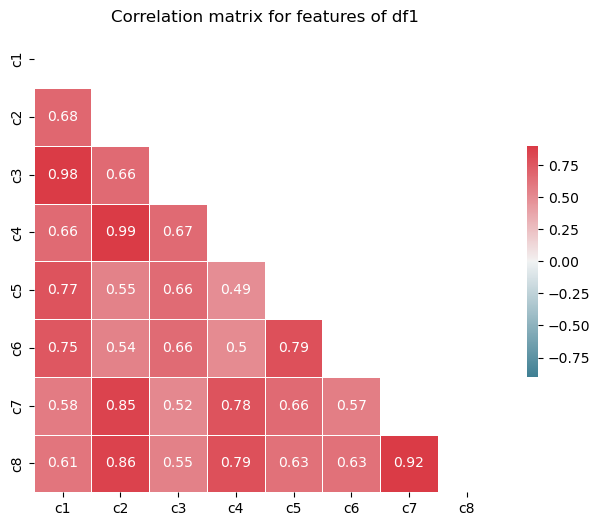

In [49]:
# Plot the correlation matrix
numeric = df1.select_dtypes(include=['float']).columns
df = df1[numeric]
corr = df.corr()
# Generate a mask for the upper triangle; True = do NOT show
mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(8, 6))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

sns.heatmap(
    corr,
    mask=mask,
    cmap=cmap,
    annot=True,
    vmax=.9,
    vmin=-.9,
    center=0,   
    square=True, 
    linewidths=.5,
    cbar_kws={"shrink": .5}
);
# Adding a title to the plot
plt.title('Correlation matrix for features of df1')

# You can save this as a png with
f.savefig('heatmap_colored_correlation_matrix_df1.png')

* Plot the violinplots for values of randomly picked grid 

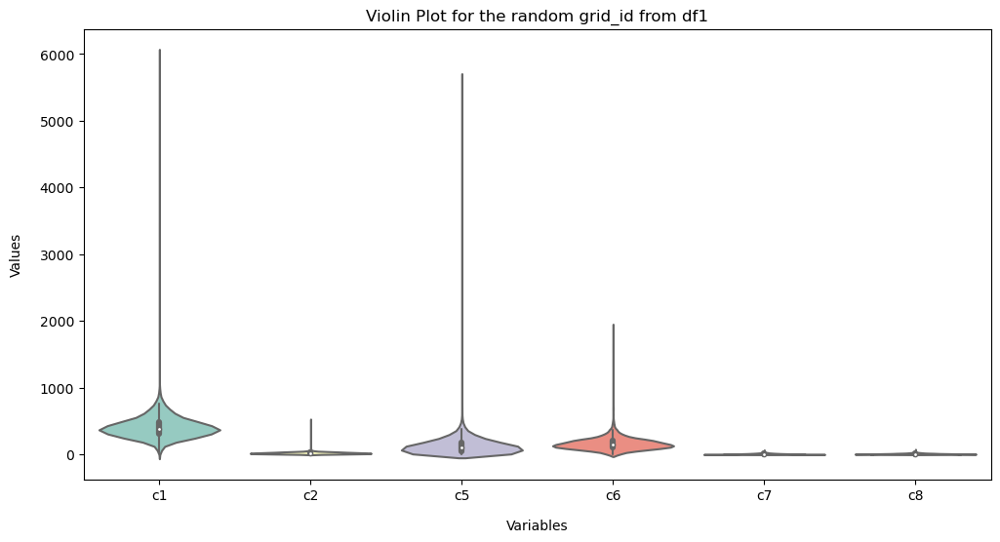

In [50]:
np.random.seed(41)
random_id = np.random.randint(1, num_cel)
fig, ax = plt.subplots(figsize=(12, 6))
sns.set_theme(style="darkgrid")
sns.violinplot(ax=ax, data=df1[df1.grid_id == random_id][['c1', 'c2', 'c5', 'c6', 'c7', 'c8']]
               , palette='Set3', scale='width')
ax.set_title('Violin Plot for the random grid_id from df1')
# Set axis labels
ax.set_xlabel("Variables", fontweight="ultralight", labelpad=12)
ax.set_ylabel("Values", fontweight="ultralight", labelpad=12)
plt.show()


As you can see, most of the variables have outlier values. To fix the problem with outliers, we can use grouping techniques with median aggregation methods.

However, for transit variables, we should pick another method to represent not the average value, but the count of the number of transitions by period.

* Grouping dataframe by `grid_id`, `day_of_week` and `period_1h` interval.

In [51]:
# Create hour column
df1['hour'] = df1.datetime.dt.hour
df1.head(1)

,grid_id,datetime,c1,c2,c3,c4,c5,c6,c7,c8,date,day_of_week,day_name,period_3h,hour
0,1,2022-09-07 12:30:00,3.69,0.0,3.69,0.0,0.0,5.28,0.0,0.0,2022-09-07,2,Wednesday,4,12


In [52]:
# Grouping dataframe by `grid_id`, `day_of_week` and `period_1h` interval.
df1_h = (df1.groupby(by=['grid_id', 'day_of_week', 'day_name', 'hour']).agg({
    'c1': np.median,
    'c2': np.median,
    'c3': np.median,
    'c4': np.median,
    'c5': np.sum,
    'c6': np.sum,
    'c7': np.sum,
    'c8': np.sum
}).reset_index())
df1_h.shape

(628824, 12)

In [53]:
# Print header of df
df1_h.head(1)

,grid_id,day_of_week,day_name,hour,c1,c2,c3,c4,c5,c6,c7,c8
0,1,0,Monday,0,0.0,0.0,0.0,0.0,30.57,24.14,8.96,0.0


* Grouping dataframe by `grid_id`, `date`, `day_of_week` and `period_3h` interval.

In [54]:
grouped_df1 = (df1.groupby(by=['grid_id', 'date', 'day_of_week', 'day_name', 'period_3h']).agg({
    'c1': np.median,
    'c2': np.median,
    'c3': np.median,
    'c4': np.median,
    'c5': np.sum,
    'c6': np.sum,
    'c7': np.sum,
    'c8': np.sum
}).reset_index())

In [55]:
grouped_df1.head(1)

,grid_id,date,day_of_week,day_name,period_3h,c1,c2,c3,c4,c5,c6,c7,c8
0,1,2022-09-01,3,Thursday,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


* Grouping dataframe by `day_of_week` and `period_3h`.

In [56]:
df1_by_day_name = grouped_df1.groupby(by=['grid_id', 'day_of_week', 'day_name', 'period_3h']).median(numeric_only=True).reset_index()
print(df1_by_day_name.shape , '\n')


(209608, 12) 



* Grouping dataframe by `period_3h`.

In [57]:
df1_by_period = grouped_df1.groupby(by=['grid_id', 'period_3h']).median(numeric_only=True).drop(columns='day_of_week').reset_index()
print(df1_by_period.shape , '\n')


(29944, 10) 



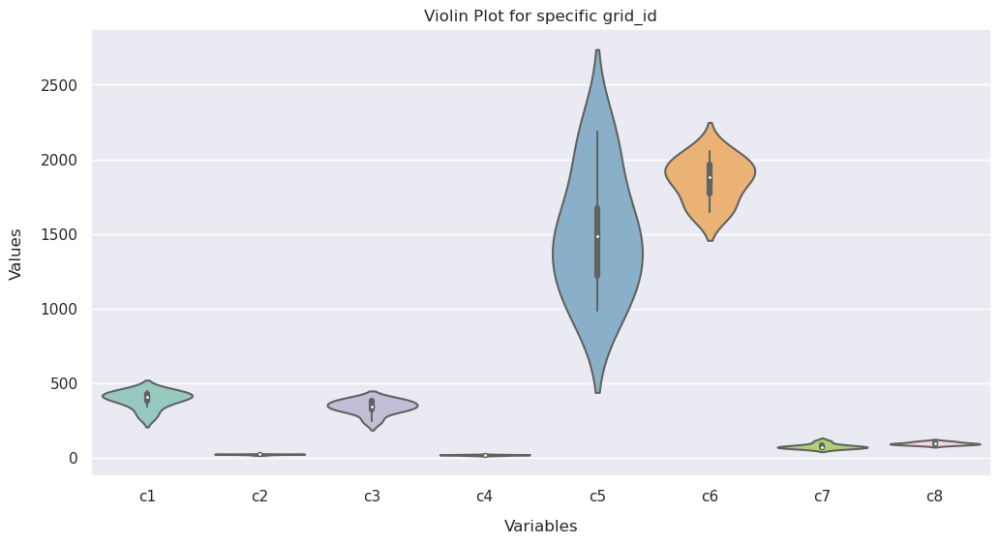

In [58]:
fig, ax = plt.subplots(figsize=(12, 6))
sns.set_theme(style="darkgrid")
sns.violinplot(ax=ax, 
               data=df1_by_period[df1_by_period.grid_id == random_id][['c1','c2','c3','c4','c5','c6','c7','c8']]
               , palette='Set3', scale='width')
ax.set_title('Violin Plot for specific grid_id')
# Set axis labels
ax.set_xlabel("Variables", fontweight="ultralight", labelpad=12)
ax.set_ylabel("Values", fontweight="ultralight", labelpad=12)
plt.show()

* Transfor the new datasets to GeoDataFrame and save them.

In [59]:
# Read grid_id
path = check_path(path_dataset3, 0)
grid_id = gpd.read_parquet(path.with_name('grid_id.parquet'))
# Create gdf's
gdf1_h = df1_h.join(grid_id, on='grid_id')
gdf1_h = gpd.GeoDataFrame(gdf1_h, geometry='geometry',)

grouped_gdf1 = grouped_df1.join(grid_id, on='grid_id')
grouped_gdf1 = gpd.GeoDataFrame(grouped_gdf1, geometry='geometry')

gdf1_by_day_name = df1_by_day_name.join(grid_id, on='grid_id')
gdf1_by_day_name = gpd.GeoDataFrame(gdf1_by_day_name, geometry='geometry')

gdf1_by_period = df1_by_period.join(grid_id, on='grid_id')
gdf1_by_period = gpd.GeoDataFrame(gdf1_by_period, geometry='geometry')

# Save gdf's as a parquet file
path = check_path(path_dataset1, 0)
gdf1_h.to_parquet(path.with_name('gdf1_h.parquet'))

grouped_gdf1.to_parquet(path.with_name('grouped_gdf1.parquet'))

gdf1_by_day_name.to_parquet(path.with_name('gdf1_by_day_name.parquet'))

gdf1_by_period.to_parquet(path.with_name('gdf1_by_period.parquet'))
 

Path contains 4 files
File format .xlsx
Path contains 3 files
File format .csv


Deleting all df objects from memory. On the next steps we will be loading gdf as parquet files from working dir.

In [60]:
# Del objects
#del df
#del df1
#del df1_h
#del grouped_df1
#del df1_by_day_name
#del df1_by_period
#del grid_id
del gdf1_h
gc.collect()

5100

#### DataFrame 2

* Number of mobile phones entering and leaving the city every 15 minutes on the 11 main road axes in the city of Lisbon

In [61]:
# Read df's
path = check_path(path_dataset2, 0)
df2 = pd.read_parquet(path.with_name('df2.parquet'))
df2['date'] = df2['datetime'].dt.date
df2['hour'] = df2['datetime'].dt.hour
df2['day_of_week'] = df2['datetime'].dt.dayofweek

Path contains 1 file
File format .csv


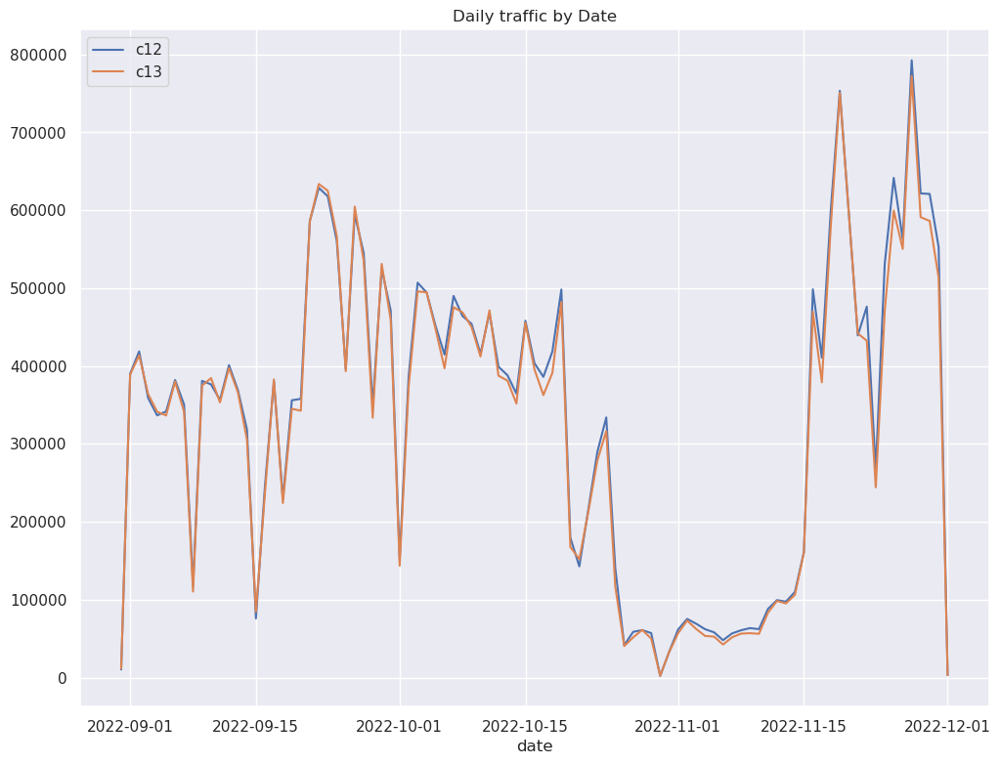

In [62]:
# daily traffic
(
df2.groupby(['date'])[['c12', 'c13']]
 .sum()
 .plot(figsize=(12, 9), grid=True)
)
plt.title('Daily traffic by Date')
plt.show()

_It's evident that some of the data is missing in the above section. Therefore, let's create a new dataframe that contains the correct hourly data._

In [63]:
# del wrong data
remove_date = pd.to_datetime(({'year': [2022, 2022],
                   'month': [10, 11],
                   'day': [27, 15]})).dt.date
df2_corr = df2.loc[(df2['date'] < remove_date[0]) | (df2['date'] > remove_date[1])]
hourly_traffic = (df2_corr
    .groupby(['eixo', 'date','day_of_week','hour'])[['c12', 'c13']]
    .sum()
    .reset_index()
    )    

### EDA

Information on the number of active mobile phones per square of 200m/200m every 15 minutes - Squares of the city of Lisbon

* C.1 Number of distinct terminals in the grid
* C.2 Number of different terminals, in roaming, in the grid
* C.3 Number of different terminals that remained in the grid
* C.4 Number of different terminals that remained in the grid, in roaming
* C.5 Number of different terminal entries in the grid
* C.6 Number of different terminal outputs in the grid
* C.7 Number of different terminal entries, in roaming, in the grid
* C.8 Number of outputs from different terminals, in roaming, in the grid

*"Note: the point in the data values is a decimal separator.
For example a value of 3.69 means 3 (approximately 4) cell phones. 
These values were derived by an algorithm for estimating the total number of devices (including those from other operators)."*

In [5]:
# Download gdf's
grid_id = gpd.read_parquet(dir_path / 'DISPOSITIVOS MOVEIS_QUADRICULAS' / 'grid_id.parquet')
gdf1_h = gpd.read_parquet(dir_path / 'DISPOSITIVOS MOVEIS_GRELHA E EIXOS' / 'gdf1_h.parquet')


In [65]:
# Download gdf's
#grouped_gdf1 = gpd.read_parquet(dir_path / 'DISPOSITIVOS MOVEIS_GRELHA E EIXOS' / 'grouped_gdf1.parquet')
#gdf1_by_period = gpd.read_parquet(dir_path / 'DISPOSITIVOS MOVEIS_GRELHA E EIXOS' / 'gdf1_by_period.parquet')

In [6]:
# Create a DatetimeIndex with a frequency of 3 hours starting from 1 AM
dti = pd.date_range(start='2023-04-13 01:00:00', end='2023-04-14 00:00:00', freq='3H').time

# Create a dictionary with keys as time strings and values as the corresponding 3-hour intervals
period_dict = {}
for i, ts in enumerate(dti):
    period_dict[i+1] = str(ts)
# Convert to DataFrame   
period_ = pd.DataFrame(period_dict, index=['start_of_period_3h']).T
period_

,start_of_period_3h
1,01:00:00
2,04:00:00
3,07:00:00
4,10:00:00
5,13:00:00
6,16:00:00
7,19:00:00
8,22:00:00


In [7]:
#night_grid = gdf1_by_period[gdf1_by_period.period_3h == 1].set_index('grid_id')
night_grid = gdf1_h[gdf1_h.hour == 3].set_index('grid_id')
night_grid.head(2)

,day_of_week,day_name,hour,c1,c2,c3,c4,c5,c6,c7,c8,geometry
grid_id,,,,,,,,,,,,
1,0,Monday,3,0.0,0.0,0.0,0.0,62.25,26.73,6.33,0.0,"POLYGON ((-9.22413 38.69139, -9.22592 38.69139..."
1,1,Tuesday,3,0.0,0.0,0.0,0.0,20.73,30.63,0.00,0.0,"POLYGON ((-9.22413 38.69139, -9.22592 38.69139..."


#### Density of terminals
* The number of terminals remaining in the cell during the period from 03:00 to 04:00 on Monday.

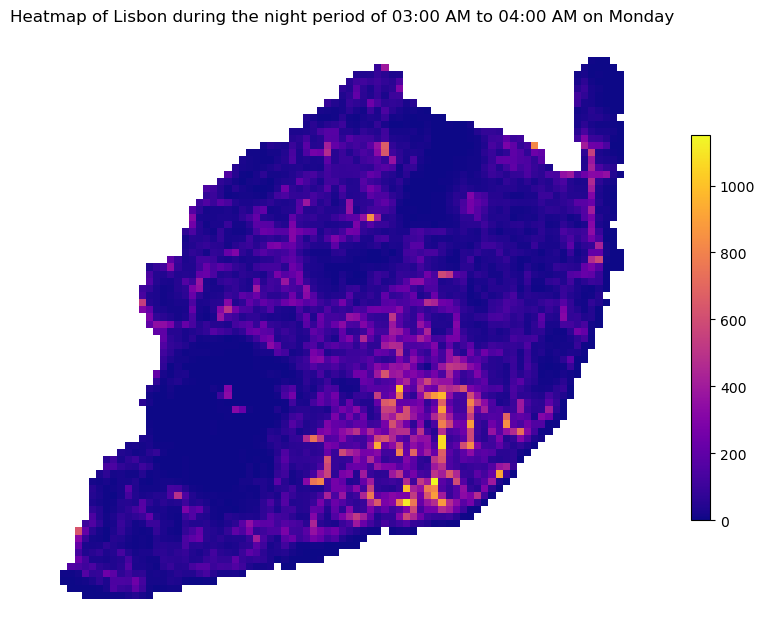

In [8]:
# Plot heatmap for density of terminals in the grid

ax = night_grid.query('day_of_week == 1').plot(figsize=(10, 10), column="c3", cmap='plasma',linewidth=0.01)
ax.set_title("Heatmap of Lisbon during the night period of 03:00 AM to 04:00 AM on Monday")

vmin= 0
vmax = night_grid.query('day_of_week == 1')['c3'].max()
sm = ScalarMappable(norm=Normalize(vmin=vmin, vmax=vmax), cmap='plasma')
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, shrink=0.5)
ax.axis("off");


* In this heatmap, we can see grid cells with different levels of density of mobile users.
* We can assume typical values for the density based on the heatmap.
* To create this heatmap, we used the c3 values, which represent the number of different terminals that remained in the grid.

Create a bar plot to present the median of density in the grid for Lisbon according to the weekday.

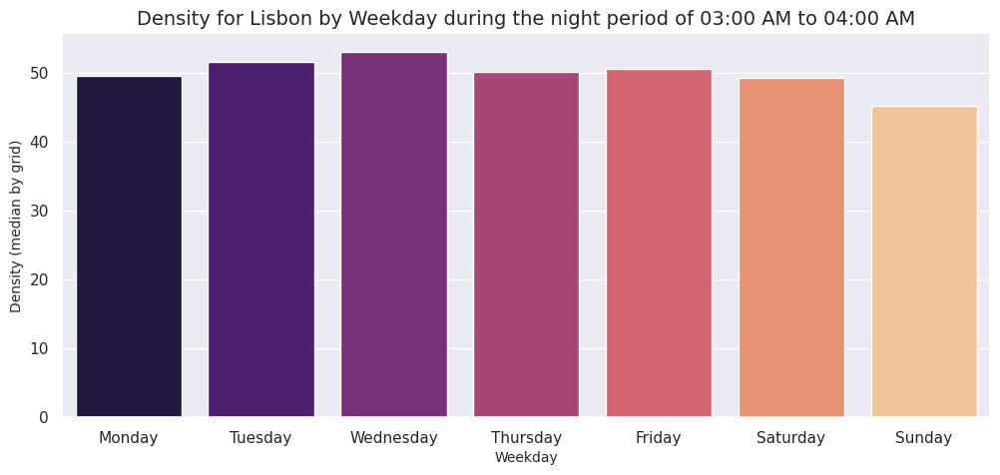

In [69]:
# Create bar plot
df =  night_grid.groupby(['day_name','day_of_week']).median(numeric_only=True).reset_index().sort_values('day_of_week')
plt.figure(figsize=(12, 5))
sns.barplot(x='day_name', y='c3', data=df, palette="magma")
plt.title('Density for Lisbon by Weekday during the night period of 03:00 AM to 04:00 AM', fontsize=14)
plt.xlabel('Weekday', fontsize=10)
plt.ylabel('Density (median by grid)', fontsize=10)
plt.show()

* **Recreate the existing heatmap plot for terminals in roaming.**

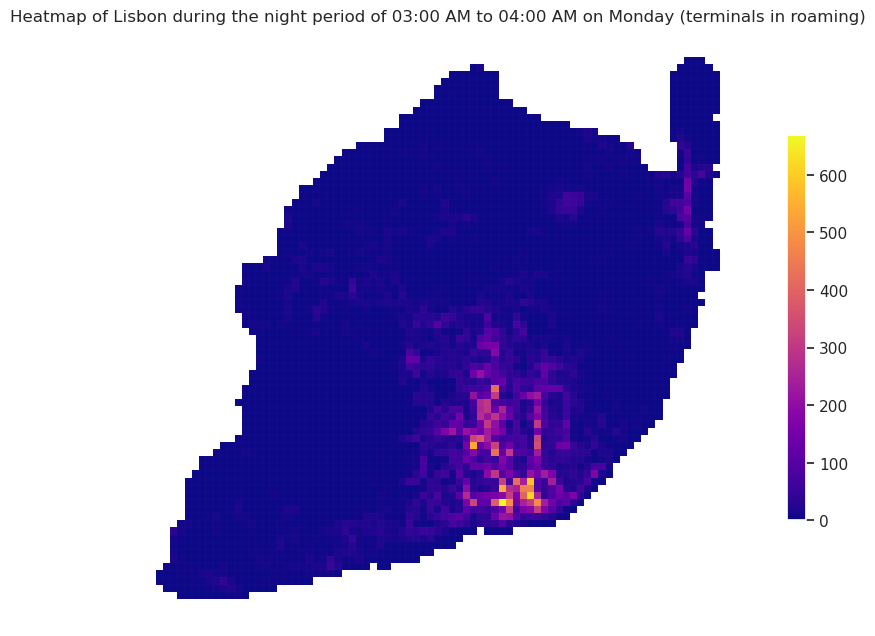

In [70]:
ax = night_grid.query('day_of_week == 1').plot(figsize=(10, 10), column="c4", cmap="plasma",linewidth=0.01)
ax.set_title("Heatmap of Lisbon during the night period of 03:00 AM to 04:00 AM on Monday (terminals in roaming)")

vmin= 0
vmax = night_grid.query('day_of_week == 1')['c4'].max()
sm = ScalarMappable(norm=Normalize(vmin=vmin, vmax=vmax), cmap='plasma')
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, shrink=0.5)
ax.axis("off");

* We can assume typical values for the density based on the heatmap.
* To create this heatmap, we used the c4 values, which represent the number of different terminals that remained in the grid, in roaming.

##### Observations about the density of terminals

* Under the density of terminals, we understand the number of different terminals that remained in the grid. These data may have a direct correlation with the population density in this cell, provided that we are taking into account the period of low user activity for calculation. In our case, this is from 03 AM to 04 AM on Monday.

* In the first image, we can see grid cells with different levels of density of all mobile users. The density in the central areas of the city is higher than in the remote areas. Nevertheless, we see average density values almost everywhere, except for park zones and industrial areas.

* In the last image, we can see grid cells with different levels of density of mobile users in roaming. Here it can be seen that tourists are mainly located in the central areas of the city of Lisbon.

* Nevertheless, the main transit zones such as the airport and train stations are also shown on these two maps, although we understand that people do not live there. But in the raw data, values are given at 15-minute intervals, so a user who stays in a cell for more than 15 minutes will be interpreted as residing in that cell according to our density calculations.

#### Transit metrics

For calculating trasit metrics for each grid cell we will be use values from Dataset 1. 
* C.5 Number of different terminal entries in the grid
* C.6 Number of different terminal outputs in the grid

* `transit` = (`C5` + `C6`)/2

By taking the sum of "C5" and "C6" and dividing by two, this metric provides an estimate of the number of terminal users who are transit the grid cell at any given time period.

 * Create a plot to better understand transit values by day and hour of the day.

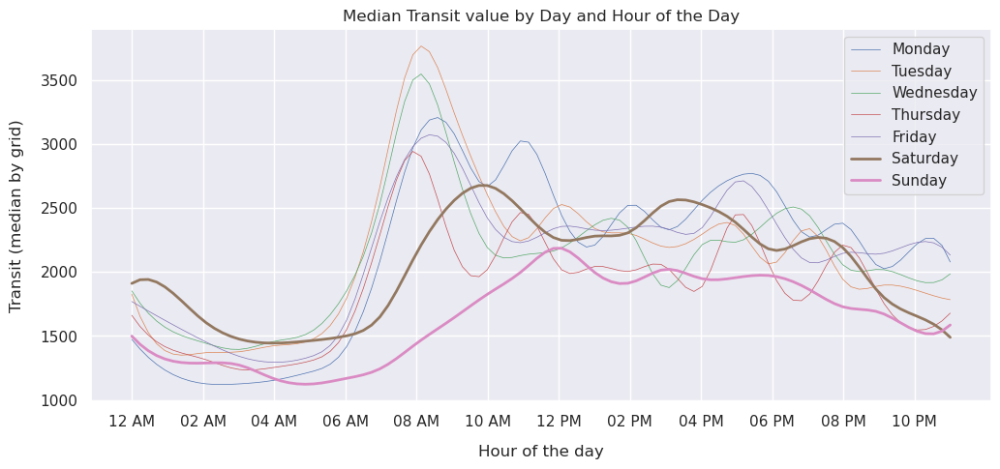

In [71]:
#Plot the transit by day and hour of the day

xticklabels = []
for i in np.arange(0, 24, 2):
        hour_str = '{:02d} {}'.format((i % 12) or 12, 'AM' if i < 12 else 'PM')
        xticklabels.append(hour_str)

df = gdf1_h.groupby(['day_name', 'hour']).median(numeric_only=True).reset_index()
df['transit'] = (df.c5 + df.c6)/2
fig, ax = plt.subplots(figsize=(12, 5))
# Create a smooth line plot with hue
x_vals = np.linspace(df['hour'].min(), df['hour'].max(), 100)
for day in ['Monday', 'Tuesday', 'Wednesday', 'Thursday',
            'Friday', 'Saturday', 'Sunday']:
    # Filter the data by day
    day_data = df[df['day_name'] == day]
    # Create an interpolation function for the data
    interp_func = make_interp_spline(day_data['hour'], day_data['transit'])
    # Evaluate the interpolation function at x_vals
    y_vals = interp_func(x_vals)
    # Set the linewidth based on the day
    linewidth = 2 if day in ['Saturday', 'Sunday'] else 0.5
    # Create a line plot for the day
    sns.lineplot(x=x_vals, y=y_vals, label=day, linewidth=linewidth)



# Set xticks and xticklabels
xticks = np.arange(0, 24, 2)
ax.set_xticks(xticks)
ax.set_xticklabels(xticklabels, fontweight="ultralight")
# Set axis labels
ax.set_xlabel("Hour of the day", fontweight="ultralight", labelpad=12)
ax.set_ylabel('Transit (median by grid)', fontweight="ultralight", labelpad=12)
# Show the plot
ax.set_title('Median Transit value by Day and Hour of the Day', fontweight='ultralight')
plt.legend()
plt.savefig(f"median_transit.png", dpi=120)
plt.show()


In the above graph we can see:

* A rapid increase in the number of transit intersections within the urban grid cells from 6 AM to 9 AM, followed by a sharp decrease to average levels on weekdays.
* On weekends, the increase in the number of transit intersections within the urban grid cells is not as sharp and is spread over time from 7 AM to 10 AM on Saturdays and from 7 AM to 12 PM on Sundays.

Create a bar plot to present the median of transitions for Lisbon according to the weekday.

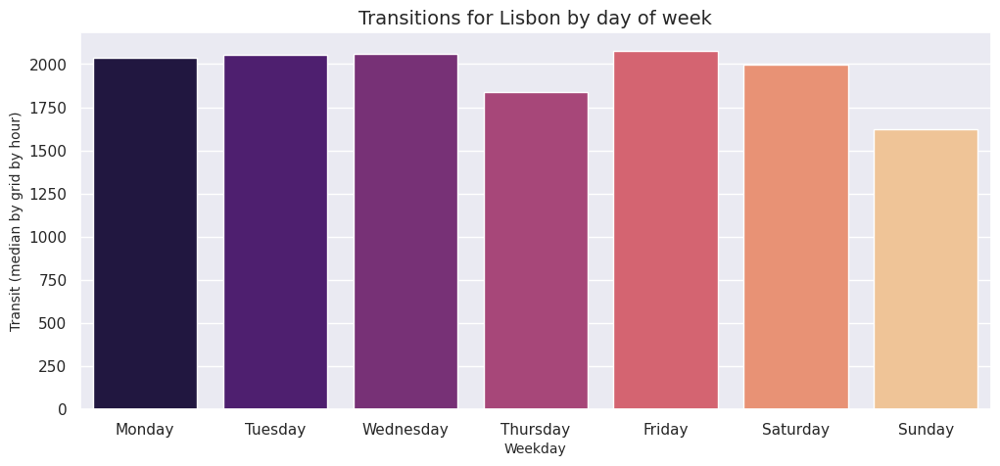

In [72]:
# Create bar plot
df =  gdf1_h.groupby(['day_name','day_of_week']).median(numeric_only=True).reset_index().sort_values('day_of_week')
df['transit'] = (df.c5 + df.c6)/2
plt.figure(figsize=(12, 5))
sns.barplot(x='day_name', y='transit', data=df, palette="magma")
plt.title('Transitions for Lisbon by day of week', fontsize=14)
plt.xlabel('Weekday', fontsize=10)
plt.ylabel('Transit (median by grid by hour)', fontsize=10)
plt.savefig(f"transitions_Lisbon_by_day_of_week.png", dpi=120)
plt.show()

##### Observations about the transit 

* In the first image, we can see the difference in transit data between weekdays and weekends. This gives us a better understanding of user activity depending on the time and day of the week. However, this graph shows median data for the entire city of Lisbon and does not show points on the city map with high activity.

* We provide the second bar plot to help understand the difference in transit data between days. In our opinion, the difference between Thursday and other weekdays is interesting. We could not determine the reason for this decrease in transit activity. For Sunday, the drop in transit activity seems expected to us.

* Will be interesting to see the high activity areas on the city map.

#### Dynamic heatmap

* Create a dynamic heatmap of transit for Lisbon.

_Cell with code bellow generate a lot of images with heatmap of transit activity._

In [121]:
# Create gif for transit
plt.ioff()

directory = "transit"
parent_dir = "."
path = os.path.join(parent_dir, directory)
os.makedirs(path, exist_ok=True)

# Loop over days of the week and hours
for d in range(7):
    df = gdf1_h[gdf1_h.day_of_week == d].copy()
    day_n = df.day_name.unique()[0]
    for i in range(0,24):
        hour_str = '{:02d}:00 {}'.format((i % 12) or 12, 'AM' if i < 12 else 'PM')
        df_h = df[df.hour == i].copy()
        df_h['transit'] = (df_h.c5 + df_h.c6)/2
        fig, ax = plt.subplots(figsize=(8, 10))
        ax.set_title(f'Transit on {day_n} at {hour_str}.')
        ax.axis("off")
        # Create heatmap
        cmap = "plasma"
        vmin, vmax = 0, 55700
        sm = ScalarMappable(norm=Normalize(vmin=vmin, vmax=vmax), cmap=cmap)
        sm.set_array([])  # create empty array to match the data
        df_h.plot(ax=ax, column="transit", cmap=cmap, linewidth=0.01, vmax=vmax, aspect=1)
        # Add colorbar
        cbar = plt.colorbar(sm, ax=ax, shrink=0.5)
        cbar.ax.set_ylabel('')
        # Save figure
        plt.savefig(f"transit/heatmap_t_{d}_{i}.png", bbox_inches='tight', dpi=120)
        plt.close(fig)
        del df_h
del df

_Cell with code bellow generate a gif file with heatmap of transit activity._

In [124]:
import imageio.v2 as imageio
image_paths = []
for d in range(7):
    for i in range(24):
        path = f"transit/heatmap_t_{d}_{i}.png"
        image_paths.append(path)
    
#image_paths = [path for path in image_paths for _ in range(4)]

with imageio.get_writer('transit.gif', mode='I', fps=2) as writer:
    for filename in image_paths:
        image = imageio.imread(filename)
        writer.append_data(image)

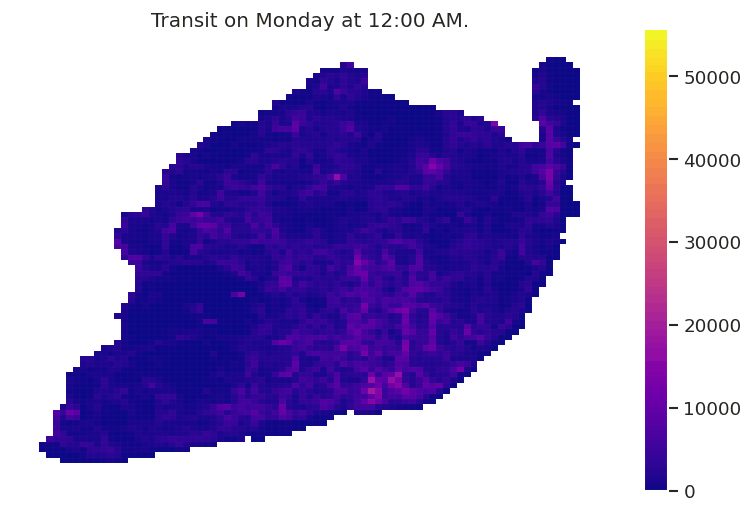

In [125]:
# Disolay gif file
from IPython.display import Image
plt.ion()
with open('transit.gif','rb') as f:
    display(Image(data=f.read(), format='gif', width=800, height=1000)) 

##### Observations about the dynamic heatmap 

* In this heatmap, we can see grid cells with different levels of transit values with dynamic visualisation.
* All peaks on the line plot 'Median Transit value by Day and Hour of the Day' that we provided above can be seen in this dynamic map with another level of granularity.
* For a better understanding of key areas with high transit values, it may be necessary to have a better understanding of the city's infrastructure. We believe that the local residents of Lisbon will be able to easily identify such areas.
* Next, we will try to identify only some infrastructure objects and areas where, in our opinion, there is a high level of mobility during morning and evening hours.


#### Transit by 07AM - 10AM

In [76]:
# Load gdf
gdf1_by_period = gpd.read_parquet(dir_path / 'DISPOSITIVOS MOVEIS_GRELHA E EIXOS' / 'gdf1_by_period.parquet')
gdf1_by_period['transit'] = (gdf1_by_period.c5 + gdf1_by_period.c6)/2


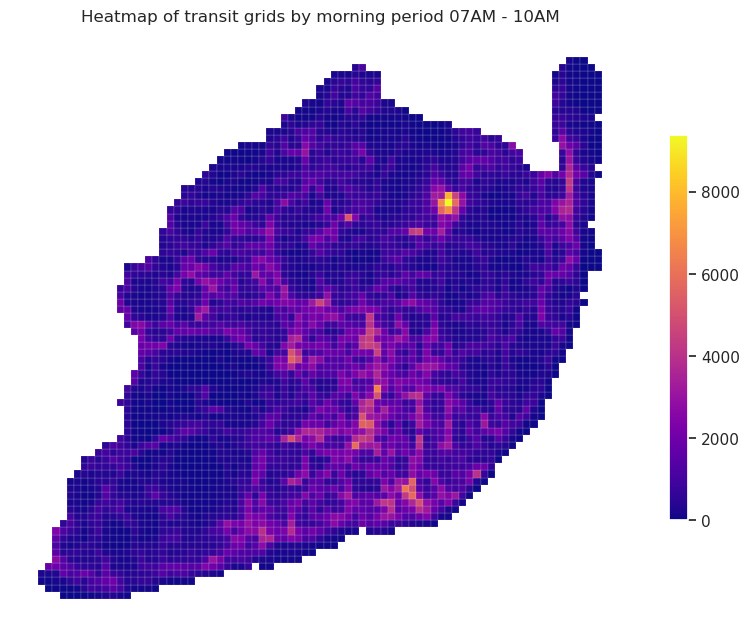

In [77]:
# Plot optimisational grid h3 for districts
df = gdf1_by_period[gdf1_by_period.period_3h == 3]
ax = df.plot(figsize=(10, 10), column="transit", cmap="plasma",linewidth=0.1, edgecolor="white")
vmin, vmax = 0, df.transit.max()
sm = ScalarMappable(norm=Normalize(vmin=vmin, vmax=vmax), cmap="plasma")
sm.set_array([])  # create empty array to match the data
# Add colorbar
cbar = plt.colorbar(sm, ax=ax, shrink=0.5)
cbar.ax.set_ylabel('')
ax.set_title("Heatmap of transit grids by morning period 07AM - 10AM")
plt.savefig(f"Transit_morning.png", dpi=120)
ax.axis("off");

#### Transit by 04PM - 07PM

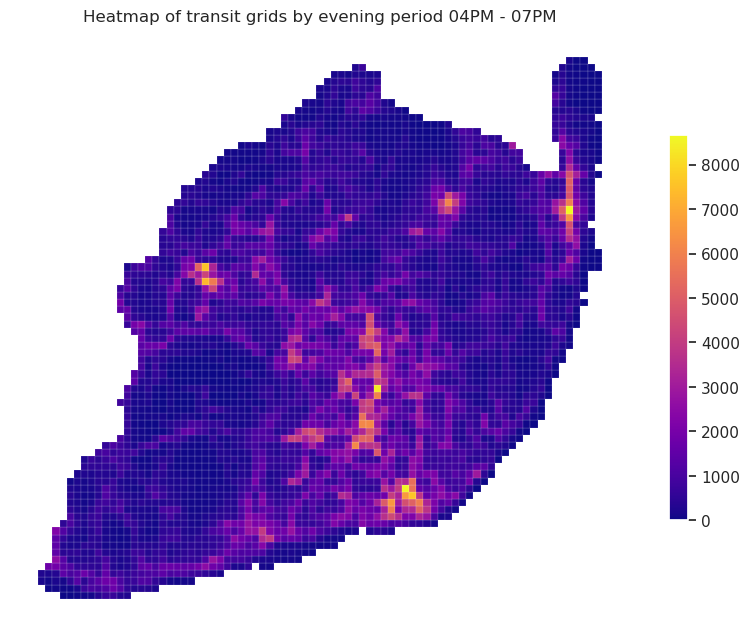

In [78]:
# Plot optimisational grid h3 for districts
plt.ion()
df = gdf1_by_period[gdf1_by_period.period_3h == 6]
ax = df.plot(figsize=(10, 10), column="transit", cmap="plasma",linewidth=0.1, edgecolor="white")
vmin, vmax = 0, df.transit.max()
sm = ScalarMappable(norm=Normalize(vmin=vmin, vmax=vmax), cmap="plasma")
sm.set_array([])  # create empty array to match the data
# Add colorbar
cbar = plt.colorbar(sm, ax=ax, shrink=0.5)
cbar.ax.set_ylabel('')
ax.set_title("Heatmap of transit grids by evening period 04PM - 07PM")
plt.savefig(f"Transit_evening.png", dpi=120)
ax.axis("off");

* _It is still not clear what type of infrastructure objects and areas we can see in these plots. To better interpret the data, we will apply it to a real map._

#### Lisbon transition map

* Heatmap of transit grids by morning period 07AM - 10AM

In [79]:
# Create heatmap on the map
gdf = gdf1_by_period.query('period_3h == 3').reset_index().copy()
fig = Figure(width="100%", height=500)
# create a map centered on the mean coordinates of the GeoDataFrame

m = folium.Map(location=[38.75, -9.15], zoom_start=12, tiles="cartodbpositron")

# add the choropleth layer to the map
folium.Choropleth(
    geo_data=gdf,
    name='choropleth',
    bins=3, # You can change number of bins
    data=gdf,
    columns=['grid_id', 'transit'],
    key_on='feature.properties.grid_id',
    fill_color= 'Reds',
    fill_opacity=0.5,
    line_opacity=0.001,
    line_color = 'white',
    legend_name='transit'
).add_to(m)

# add a layer control to the map
folium.LayerControl().add_to(m)
fig.add_child(m)
# display the map
m

* You can use the layers icon on the top right-hand side of the map to hide the data layer.
* We decreased the number of bins to 3 to show only areas with high values.


We can see high level  of transition by morning period 07AM - 10AM in the next areas:
* Aeroporto Humberto Delgado (Aeroporto the terminal station of the Lisbon Metro)
* Estação do Oriente (Oriente station of the Lisbon Metro)
* Sete-Rios train and bus station (Metro Jardim Zoológico)
* Metro Campo Pequeno
* Saldanha metro station
* Marquês de Pombal
* Santa Maria Maior

Heatmap of transit grids by evening period 04PM - 07PM

In [80]:
# Create heatmap on the map
gdf = gdf1_by_period.query('period_3h == 6').reset_index().copy()
fig = Figure(width="100%", height=500)
# create a map centered on the mean coordinates of the GeoDataFrame

m = folium.Map(location=[38.75, -9.15], zoom_start=12, tiles="cartodbpositron")

# add the choropleth layer to the map
folium.Choropleth(
    geo_data=gdf,
    name='choropleth',
    bins=3,
    data=gdf,
    columns=['grid_id', 'transit'],
    key_on='feature.properties.grid_id',
    fill_color= 'Reds',
    fill_opacity=0.5,
    line_opacity=0.001,
    line_color = 'white',
    legend_name='transit'
).add_to(m)

# add a layer control to the map
folium.LayerControl().add_to(m)
fig.add_child(m)
# display the map
m

We can see high level  of transition by evening period 04PM - 07PM in the next areas:

* Centro Comercial Colombo
* Amoreiras shopping centre
* Aeroporto Humberto Delgado (Aeroporto the terminal station of the Lisbon Metro)
* Estação do Oriente (Oriente station of the Lisbon Metro)
* Sete-Rios train and bus station (Metro Jardim Zoológico)
* etc.

##### Observations about the Lisbon transition map 

* Firstly, we can say that the main areas with high mobility values are located directly next to the main transit objects, such as airports, train stations, bus stations, and metro stations.

* Secondly, and less obvious, in the evening, the high level of mobility is located near the city's large shopping centers.

* You might be able to make more discoveries by looking at these maps in more detail.

_Remember that the level of detail can be changed by increasing the value of `bins` in the code above._

#### Traffic on main roads

* Analyzing the traffic on main 11 roads of Lisbon.

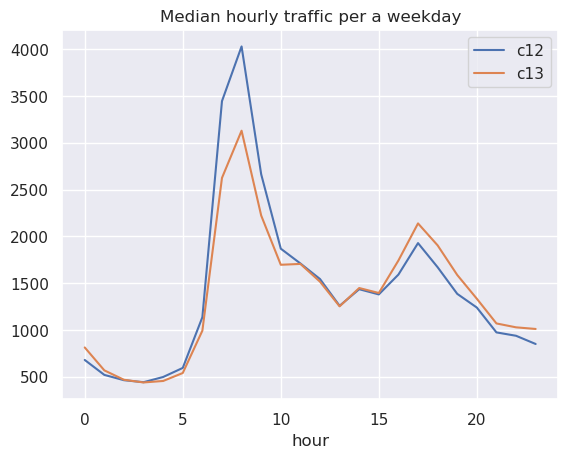

In [81]:
# median hourly traffic per a weekday
(
    hourly_traffic.query('day_of_week < 5')
 .groupby('hour')[['c12','c13']]
 .median()
 .plot()
)
plt.title('Median hourly traffic per a weekday')
plt.show()

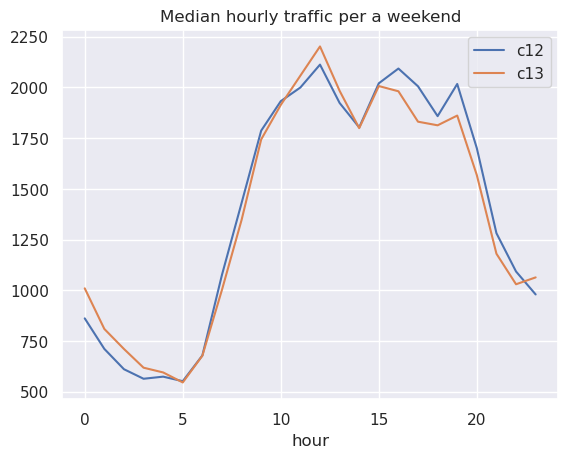

In [82]:
# median hourly traffic per a weekend
(
    hourly_traffic.loc[hourly_traffic['day_of_week'] >= 5 ]
 .groupby('hour')[['c12','c13']]
 .median()
 .plot()
)
plt.title('Median hourly traffic per a weekend')
plt.show()

We can see different patterns for weekdays and weekends.

**Exploring traffic characteristics on Lisbon main roads**

In [83]:
main_roads_names = df2_corr.loc[:,'eixo'].unique()
print(main_roads_names)

['Ponte 25 Abril' 'IC16' 'Marginal' 'IC19' 'A1' 'Calçada de Carriche'
 'N117 (Cabos Ávila)' 'A36 (Túnel do Grilo)' 'Ponte Vasco da Gama'
 'IC2 (Sacavém)' 'A5']


In [84]:
total=df2_corr.loc[:,'eixo'].value_counts()
total

Ponte 25 Abril          19399
Ponte Vasco da Gama     19398
Marginal                19395
IC16                    19394
N117 (Cabos Ávila)      19394
A36 (Túnel do Grilo)    19394
A5                      19394
IC2 (Sacavém)           19393
A1                      19392
Calçada de Carriche     19392
IC19                    19390
Name: eixo, dtype: int64

Save the plot of median hourly traffic per a weekday and weekand for main roads.

In [85]:
# median hourly traffic per a weekday and weekand for main roads
directory = "traffic"
parent_dir = "."
path = os.path.join(parent_dir, directory)
os.makedirs(path, exist_ok=True)

for name in main_roads_names:
    (hourly_traffic.loc[(hourly_traffic['day_of_week'] < 5) & (hourly_traffic['eixo'] == name)]
 .groupby('hour')[['c12','c13']]
 .median()
 .plot())
    plt.ylabel('on weekday')
    plt.title(f'Median hourly traffic for main road {name}')
    plt.savefig(f"traffic/plot_weekday_{name}.png", bbox_inches='tight', dpi=180)
    plt.close()
    
    (hourly_traffic.loc[(hourly_traffic['day_of_week'] >= 5) & (hourly_traffic['eixo'] == name)]
 .groupby('hour')[['c12','c13']]
 .median()
 .plot())
    plt.ylabel('on weekend')
    plt.title(f'Median hourly traffic for main road {name}')
    #plt.show()
    plt.savefig(f"traffic/plot_weekend_{name}.png", bbox_inches='tight', dpi=180)
    plt.close()

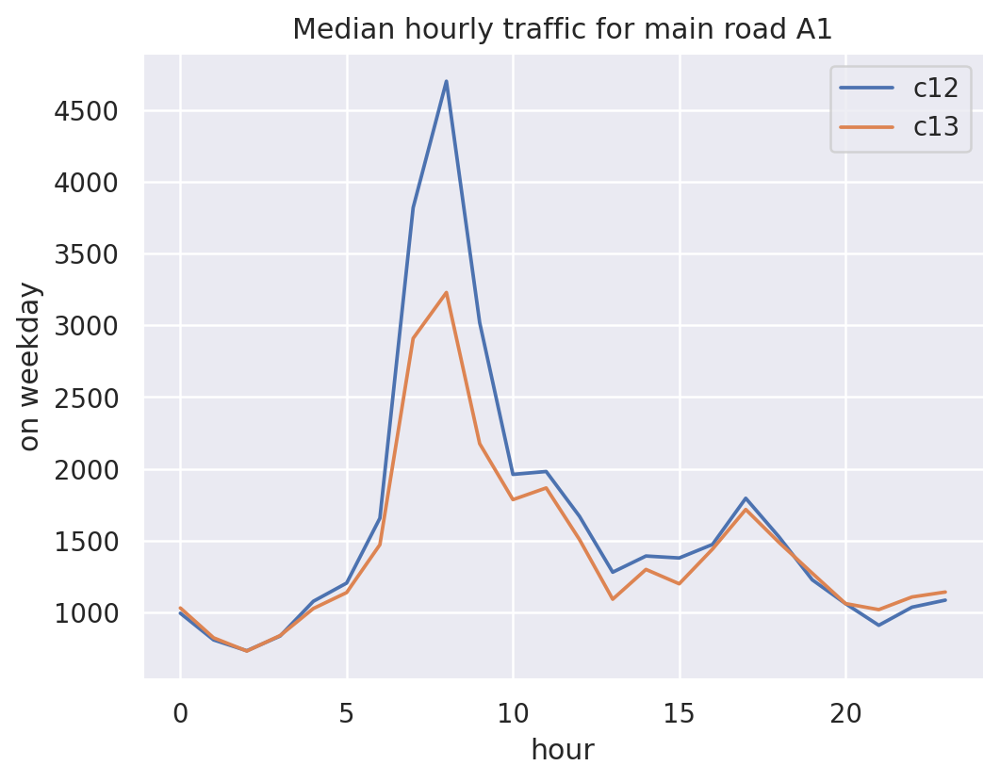

In [86]:
from IPython.display import Image
Image(filename='traffic/plot_weekday_A1.png', width=800, height=800)

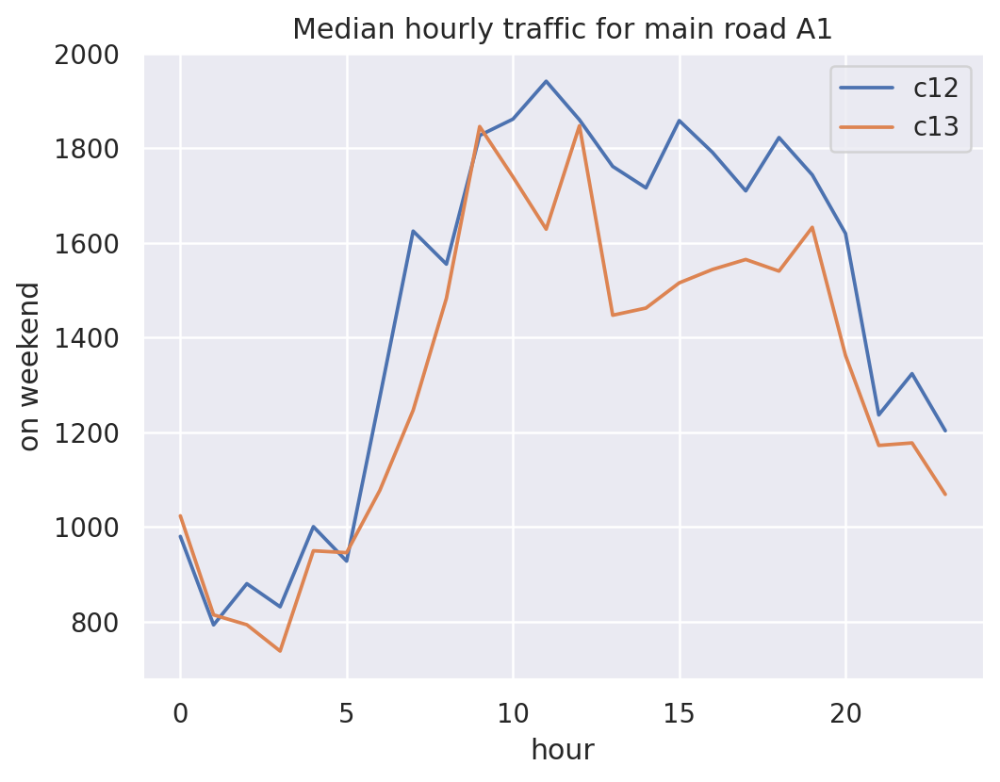

In [87]:
Image(filename='traffic/plot_weekend_A1.png', width=800, height=800)

* **Other plots for all main roads you can find in Appendix**

##### Observations about the traffic on the main roads

* On weekdays, there is a clear increase in traffic during the morning hours and a gradual increase in the evening hours. 
* On weekends, traffic increases rapidly in the morning and decreases rapidly in the evening, while remaining at an average level throughout the day. 
* On weekday mornings, the number of incoming cars is much higher than the outgoing cars, except for A5, where more cars are leaving, and N117, where the numbers are equal. 
* The main roads for entry on weekdays in the morning are IC2, IC16, and IC19.

### Clustering model

* As you may have noticed, the visualization tools have helped us acquire a deeper and more realistic understanding of the flows generated between different areas and the access points to the city, especially during periods of high traffic intensity.
* However, we will try to apply machine learning tools to identify clusters with different levels of traffic intensity.


     * We will use a simple MiniBatchKMeans model from the sklearn library.
    * Our model will be trained to predict the cluster value on the Dataset 1 (Information on the number of active mobile phones per square of 200m/200m every 15 minutes - Squares of the city of Lisbon)

Prepare the features

In [88]:
# Read the dataset
gdf1_by_day_name = gpd.read_parquet(dir_path / 'DISPOSITIVOS MOVEIS_GRELHA E EIXOS' / 'gdf1_by_day_name.parquet')

In [89]:
# Create the features from Dataset
features = pd.pivot_table(gdf1_by_day_name,values=['c3','c5','c6'], index='grid_id', columns=['day_of_week', 'period_3h'], aggfunc=np.median,)
features.shape

(3743, 168)

In [90]:
# Get values from features
X = features.values

Compute clustering with MiniBatchKMeans

In [91]:
# Assign model with hyperparametres
mbk = MiniBatchKMeans(
    init="k-means++",
    n_clusters=4,
    batch_size=120,
    n_init=10,
    max_no_improvement=10,
    verbose=0,
    random_state = 0
)
# Train model
mbk.fit(X)

MiniBatchKMeans(batch_size=120, n_clusters=4, n_init=10, random_state=0)

In [92]:
# Predict the claster number
y = mbk.predict(X)
# Convert prediction to DF
claster = pd.DataFrame(y)
claster.index = range(1, len(claster) + 1)
claster.shape

(3743, 1)

In [93]:
# Combine grid info with predictions
claster_grid = grid_id.join(claster).rename(columns={0:'claster'})
claster_gdf = gpd.GeoDataFrame(claster_grid)
# Check crs
claster_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Plotting the results

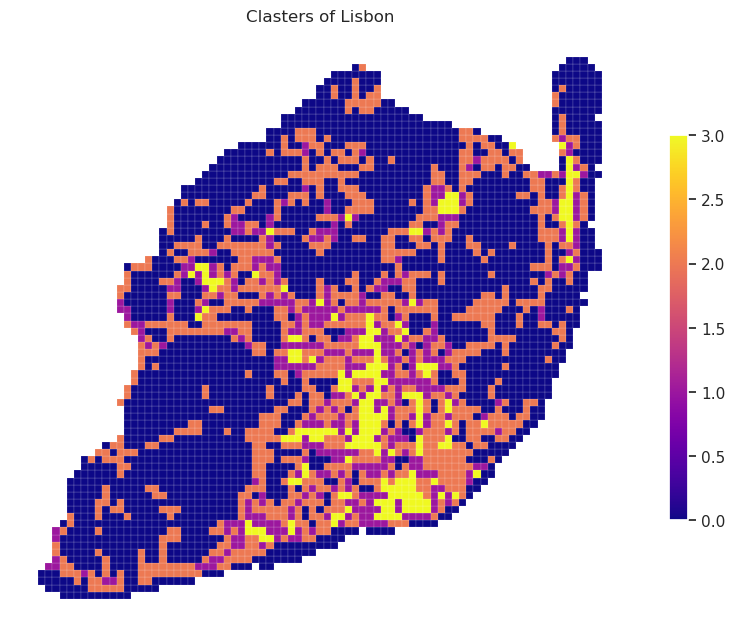

In [94]:
# Plot the classification grid

ax = claster_gdf.plot(figsize=(10, 10), column="claster", cmap='plasma',linewidth=0.1)
ax.set_title("Clasters of Lisbon")

vmin= 0
vmax = 3
sm = ScalarMappable(norm=Normalize(vmin=vmin, vmax=vmax), cmap='plasma')
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, shrink=0.5)
ax.axis("off");

In [95]:
# Change the number of clusters to separate the values
claster_gdf.claster.replace(2, 0.5, inplace=True)
claster_gdf.claster.replace(1, 2.5, inplace=True)

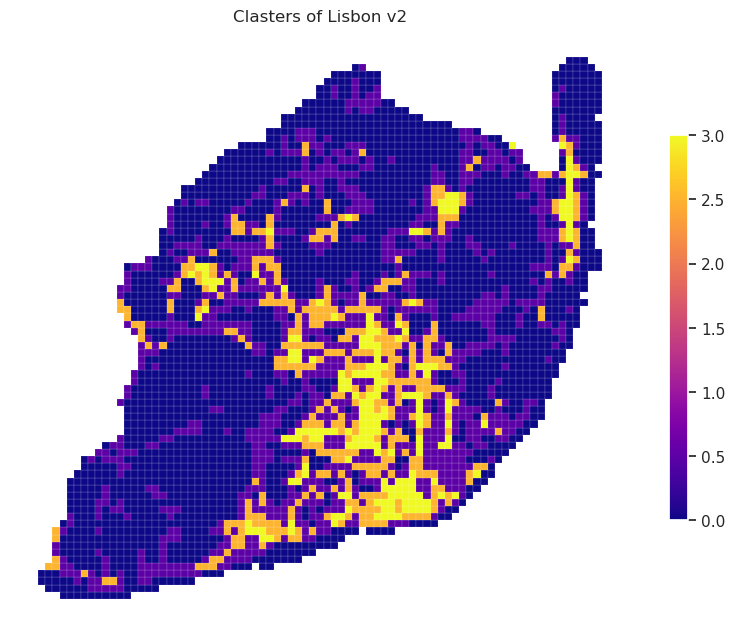

In [98]:
# Plot the classification grid

ax = claster_gdf.plot(figsize=(10, 10), column="claster", cmap='plasma',linewidth=0.1)
ax.set_title("Clasters of Lisbon v2")

vmin= 0
vmax = 3
sm = ScalarMappable(norm=Normalize(vmin=vmin, vmax=vmax), cmap='plasma')
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, shrink=0.5)
plt.savefig(f"clasters.png", dpi=120)
ax.axis("off");

It is important to remember that clustering models do not provide explicit answers as to why a particular zone ended up in a certain cluster, and additional analysis of the resulting clusters is necessary.

* Recall that our model was trained on 168 features:

    * Values of our characteristics C3, C5, C6 for each day of the week.
    * Values of our characteristics for each 3-hour period during the day.
    
    
The clustering model only looked at the differences between these values in multiple dimensions and grouped similar objects together into clusters.

In [111]:
# Plot this clasters to map

gdf = claster_gdf.reset_index().copy()
fig = Figure(width="100%", height=500)
# create a map centered on the mean coordinates of the GeoDataFrame

m = folium.Map(location=[38.75, -9.15], zoom_start=12, tiles="cartodbpositron")

# add the choropleth layer to the map
folium.Choropleth(
    geo_data=gdf,
    name='choropleth',
    bins=7,
    data=gdf,
    columns=['grid_id', 'claster'],
    key_on='feature.properties.grid_id',
    fill_color= 'Reds',
    fill_opacity=0.5,
    line_opacity=0.001,
    line_color = 'white',
    legend_name='claster'
).add_to(m)

# add a layer control to the map
folium.LayerControl().add_to(m)
fig.add_child(m)
# display the map
m

##### Observations about the Clustering model 

* We can see similarities in the patterns in this image and the images above, which tells us that the clustering model can be used for analysis.

_Analyzing the transitions value for grid cells of a city using KMeans clustering can provide several benefits, including:_

1. Identification of distinct urban areas: By clustering grid cells based on their transition values, KMeans can identify distinct urban areas within a city. This can be useful for urban planners and policymakers who want to understand the spatial distribution of different types of land use or demographic characteristics.

2. Efficient resource allocation: Understanding the spatial distribution of different urban areas can help with the efficient allocation of resources such as public services, transportation, and housing.

3. Predictive modeling: KMeans clustering can be used to predict future trends in urban development by identifying areas with similar transition patterns. This can help urban planners and policymakers anticipate changes in land use and make informed decisions about zoning and development.

4. Improved understanding of urban dynamics: By analyzing transition values over time, KMeans clustering can provide insights into the dynamic nature of urban areas and how they change over time. This can inform policy decisions related to urban planning, development, and resource allocation.

## 🖼️ Visualisations


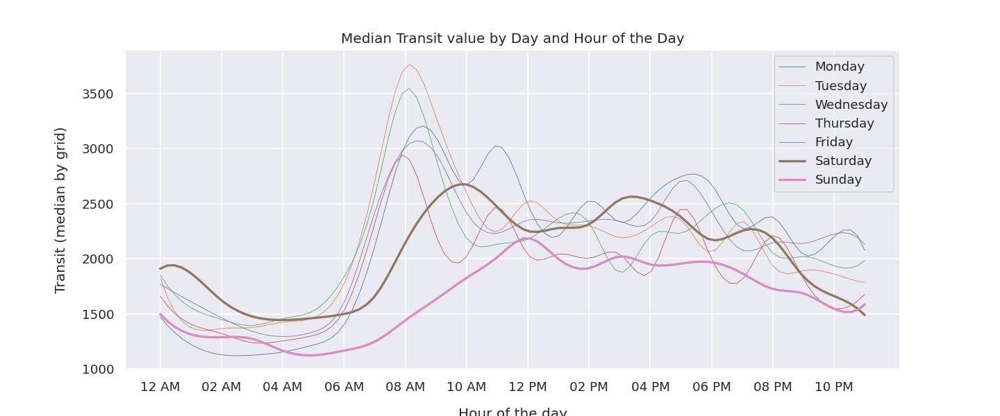

In [114]:
display(Image('median_transit.png'))

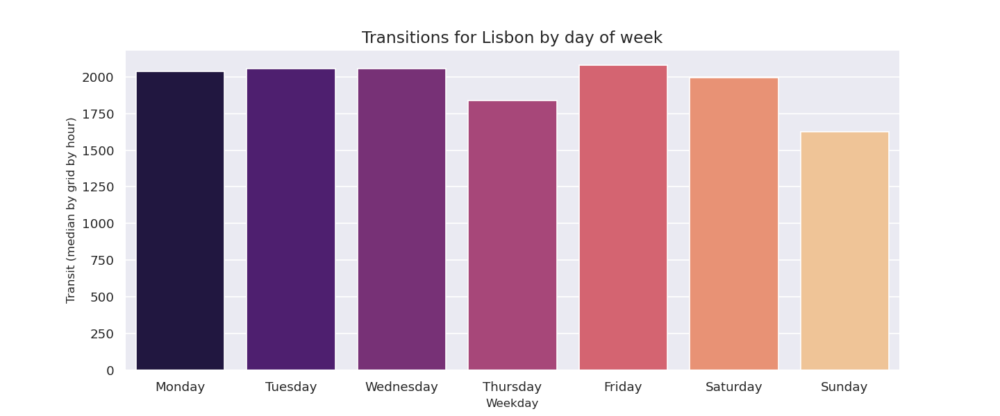

In [115]:
display(Image("transitions_Lisbon_by_day_of_week.png"))

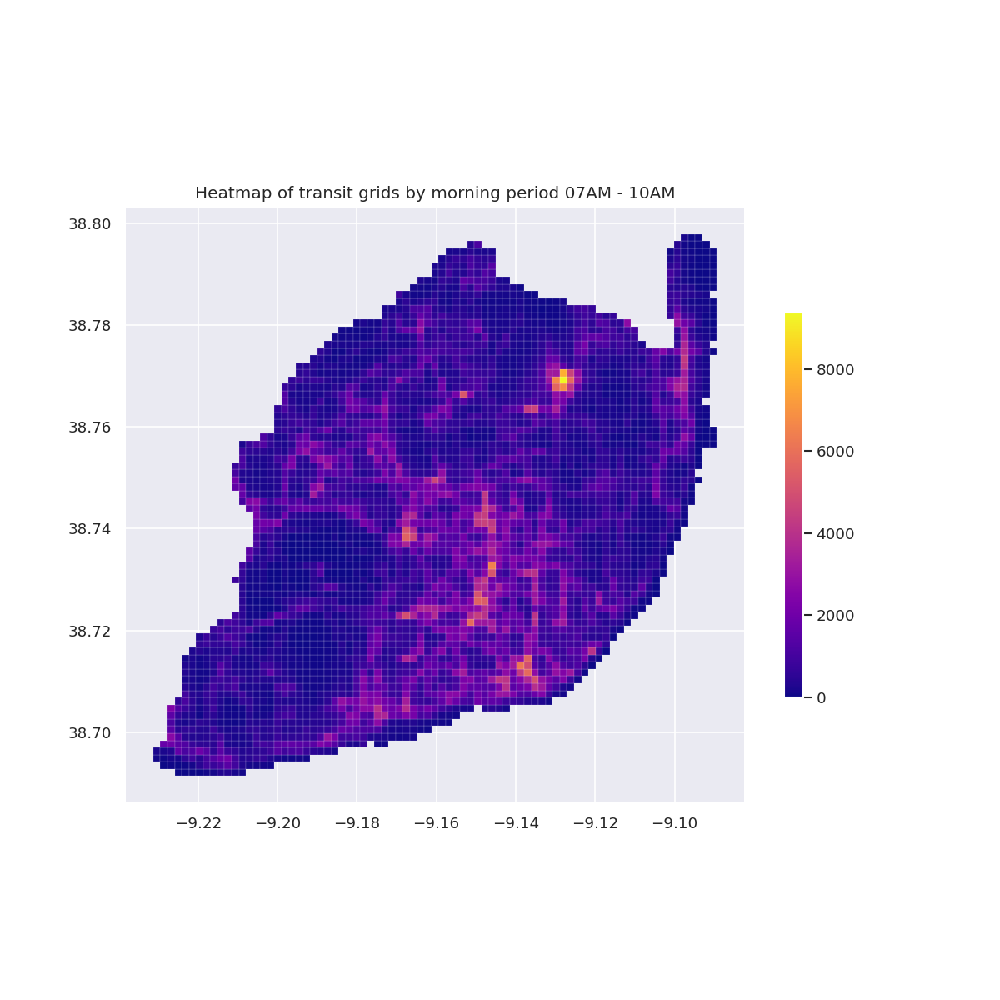

In [116]:
display(Image('Transit_morning.png'))

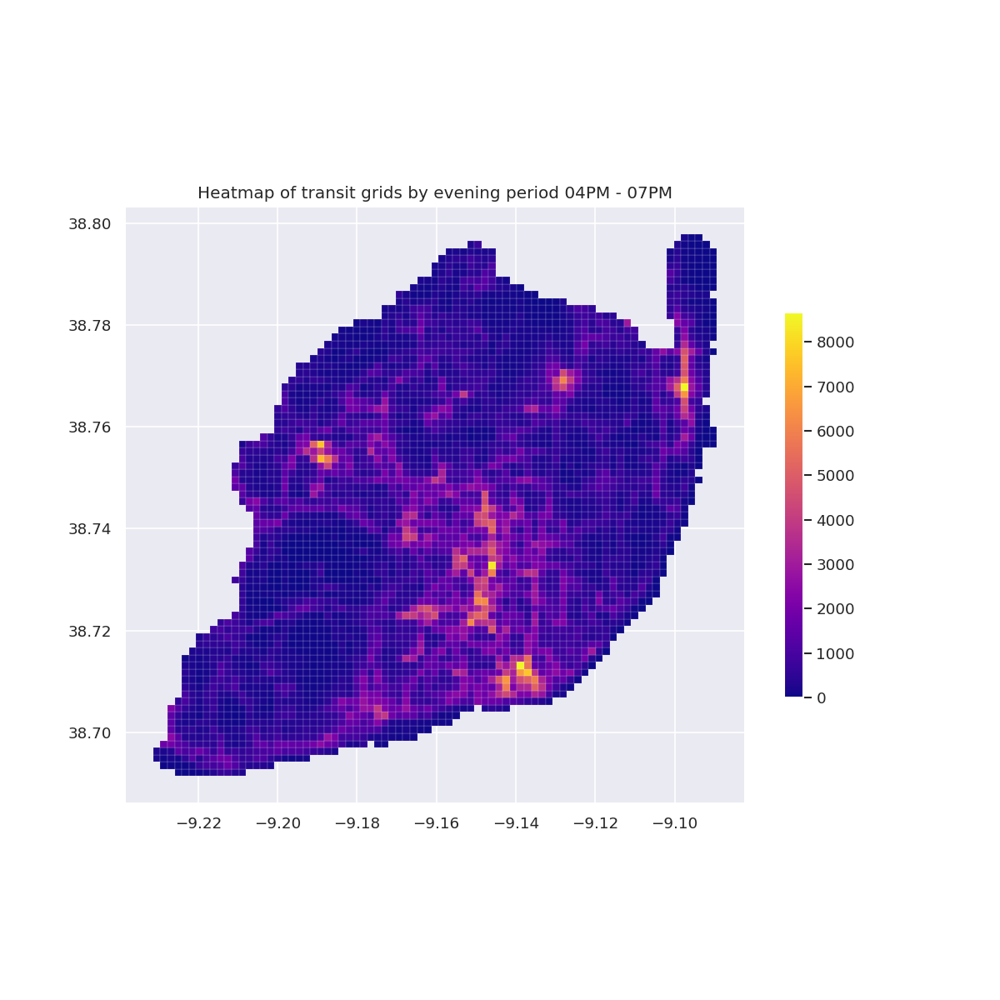

In [117]:
display(Image('Transit_evening.png'))

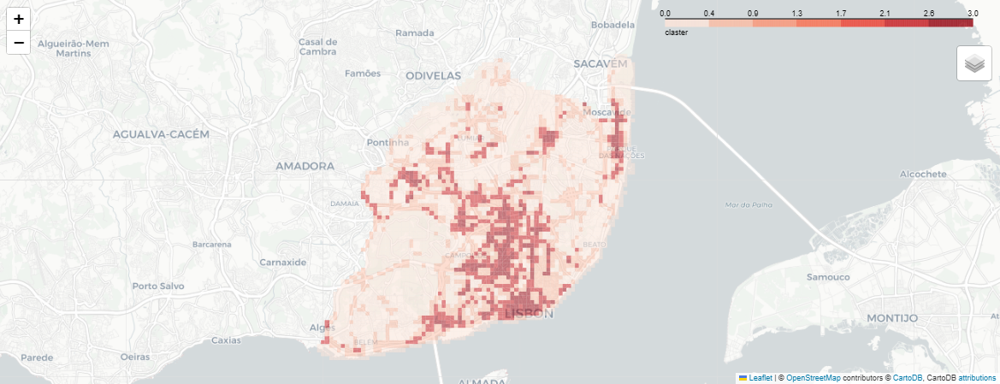

In [118]:

display(Image('clasters_map.png'))

## ⏭️ Appendix


Additional plots

In [ ]:
directory = 'traffic'

for filename in os.listdir(directory):
    if filename.endswith('.png'):
        filepath = os.path.join(directory, filename)
        display(Image(filename=filepath, width=800, height=800))